In [1]:
import pandas as pd
import numpy as np
import math as m
import warnings
warnings.simplefilter('ignore')
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows', 2000)

%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt
#графики в svg выглядят более четкими
%config InlineBackend.figure_format = 'svg' 

#увеличим дефолтный размер графиков
from pylab import rcParams
rcParams['figure.figsize'] = 8, 5

import scipy.stats as ss

### Гипотеза №1. Срок принятия по автострахованию > 1 месяца после контакта с рекламой

#### 1538 - Osago Payment - переход на последний шаг калькулятора
#### 1493 - Kasko_formalize - при нажатии на кнопку "Kasko_оформить"

In [2]:
#df1538 = pd.read_csv('1538/avg_conv_time1538.csv')
#df1538.drop(df1538.tail(2).index,inplace=True)
#df1493 = pd.read_csv('1493/avg_conv_time1493.csv')
#df1493.drop(df1493.tail(2).index,inplace=True)
#frames = [df1493, df1538]
#df1 = pd.concat(frames).reset_index(drop=True)
df1 = pd.read_csv('1538/avg_conv_time1538.csv')
df1.drop(df1.tail(2).index,inplace=True)
print(df1.shape)
#df1 = df.drop_duplicates(subset=['customer_id', 'date'])
#print(df.shape)

(800, 4)


In [3]:
#df1 = df1.loc[:799,:]
df1.count()

customer_id        800
first              800
last               800
conversion_time    800
dtype: int64

In [4]:
df1['first'] = pd.to_datetime(df1['first'])
df1['last'] = pd.to_datetime(df1['last'])
df1['conversion_time'] = df1['last']-df1['first']
df1.sort_values("conversion_time", inplace=True, ascending=False)
df1[df1["conversion_time"]>"30 days"].count()

customer_id        102
first              102
last               102
conversion_time    102
dtype: int64

In [5]:
def convert_timedelta(duration):
    days, seconds = duration.days,duration.seconds
    hours = np.round(days * 24 + seconds/3600 , 4)
    #minutes = (seconds % 3600) // 60
    #seconds = (seconds % 60)
    #hours = np.round(hours + minutes/60 + seconds/60/60,4)
    return hours

In [6]:
df1["conv_time_hours"] = df1["conversion_time"]

In [7]:
for i in range(len(df1["conv_time_hours"])):
    df1["conv_time_hours"][i] = convert_timedelta(df1["conv_time_hours"][i])

In [8]:
# проверка на нормальность
#df1["conv_time_hours"].plot()

In [9]:
#def fff(x,a):
#    return a*np.exp(-a*x)
#from scipy.stats import expon
#x = np.linspace(0,800,1000)
#fig, ax = plt.subplots(1, 1)
#ax.plot(x, fff(x,0.1))
#df1["conv_time_hours"].plot()
#plt.show()

In [10]:
#x = df1['conv_time_hours']

#shapiro_results = scipy.stats.shapiro(x)
#ks_results = scipy.stats.kstest(x, cdf='norm')
#anderson_results = scipy.stats.anderson(x)
#dagostino_results = scipy.stats.mstats.normaltest(x)
#print(shapiro_results)
#print(ks_results)
#print(anderson_results)
#print(dagostino_results)

In [11]:
#df1

### Вариант через доверительные интервалы

In [12]:
from statsmodels.stats.weightstats import _zconfint_generic, _tconfint_generic
time_conversion = list(df1["conversion_time"])
for i in range(len(time_conversion)):
    time_conversion[i] = int(str(time_conversion[i])[:2])+1
df1['day'] = time_conversion
df1['day'] = df1['day'].astype(int)
df1

,customer_id,first,last,conversion_time,conv_time_hours,day
0,SVitoOyJOUJJ,2018-05-18 17:15:06,2018-07-29 09:10:10,71 days 15:55:04,1719.92,72
1,KERQvfhslaUo,2018-05-19 08:50:40,2018-07-29 13:03:27,71 days 04:12:47,1708.21,72
2,Itq7l4p8qJwi,2018-05-17 16:48:00,2018-07-27 12:10:31,70 days 19:22:31,1699.38,71
3,3I3uK9Sk60bc,2018-05-17 08:03:47,2018-07-26 09:42:17,70 days 01:38:30,1681.64,71
4,I6xqP2Fwmwcj,2018-05-18 16:09:39,2018-07-27 10:34:31,69 days 18:24:52,1674.41,70
5,RhNgRSO0-mFG,2018-05-24 23:03:40,2018-08-01 11:25:54,68 days 12:22:14,1644.37,69
6,duwSHFM@Ix52,2018-05-18 13:55:10,2018-07-24 20:22:28,67 days 06:27:18,1614.45,68
7,4WGUvpuUQtLh,2018-05-18 15:45:24,2018-07-24 16:13:18,67 days 00:27:54,1608.46,68
8,VQfwZmZT-qNV,2018-05-21 14:20:10,2018-07-26 06:24:15,65 days 16:04:05,1576.07,66
9,EYE-DcFkbi4R,2018-05-23 11:04:40,2018-07-27 14:17:35,65 days 03:12:55,1563.22,66


In [13]:
mean = df1["day"].mean()
std = df1["day"].std(ddof=1)/np.sqrt(df1["day"].count())

In [14]:
answer = _tconfint_generic(mean, std, df1["day"].count() - 1, 0.05, 'two-sided')

In [15]:
print("Срок принятия решения по автострахованию более 1 месяца отвергается,\
      так как не входит в 95% доверительный интервал для среднего:", np.round(answer,2))

Срок принятия решения по автострахованию более 1 месяца отвергается,      так как не входит в 95% доверительный интервал для среднего: [13.29 15.17]


In [16]:
print("Срок принятия решения по автострахованию более 1 месяца отвергается,\
      так как не входит в 95% доверительный интервал для среднего:", np.round(answer,2))

Срок принятия решения по автострахованию более 1 месяца отвергается,      так как не входит в 95% доверительный интервал для среднего: [13.29 15.17]


In [17]:
#count = df1["conversion_time"].count()

In [18]:
#avg_time = df1["conversion_time"].mean()
#avg_time

In [19]:
#time_30 = df1[df1["conversion_time"]>'29 days']["conversion_time"].count()

In [20]:
#answer = np.round(time_30/count*100,1)
#answer

In [21]:
#print("Срок принятия решения по автострахованию более 1 месяца: ", answer,"% от всех конверсий по автострахованию")
#print("Среднее время принятия решения по автострахованию: 14 дней")

### Гипотеза №2. Пользователи, оформившие один из полисов – возвращаются и покупают другие продукты

#### 1493 - Kasko_formalize - при нажатии на кнопку "Kasko_оформить"
#### 1497 - Health_life_DMS_send_request - при нажатии на кнопку "Health_life_DMS_отправить заявку"
#### 1504 - Property_House_buy_online - при нажатии на кнопку "Property_отправить"
#### 1527 - travel payment - переход на последний шаг калькулятора 
#### 1534 - Incident_Payment - несчастный случай_Оплата
#### 1536 - Flat payment - переход на последний шаг калькулятора 
#### 1537 - Mortgage Payment - на кнопку оформление и получение полиса 
#### 1538 - Osago Payment - переход на последний шаг калькулятора 
#### 1540 - go payment - переход на последний шаг калькулятора 

In [28]:
df1493 = pd.read_csv('prepared_data1493.csv')
df1497 = pd.read_csv('prepared_data1497.csv')
df1504 = pd.read_csv('prepared_data1504.csv')
df1527 = pd.read_csv('prepared_data1527.csv')
df1534 = pd.read_csv('prepared_data1534.csv')
df1536 = pd.read_csv('prepared_data1536.csv')
df1537 = pd.read_csv('prepared_data1537.csv')
df1538 = pd.read_csv('prepared_data1538.csv')
df1540 = pd.read_csv('prepared_data1540.csv')

In [29]:
frames = [df1493, df1497, df1504, df1527, df1534, df1536, df1537, df1538, df1540]
df = pd.concat(frames).reset_index(drop=True)
print(df.shape)
df = df.drop_duplicates(subset=['customer_id', 'date'])
print(df.shape)

(62790, 10)
(56283, 10)


In [30]:
conv_id = [1493, 1497, 1504, 1527, 1534, 1536, 1537, 1538, 1540]

In [31]:
df_conv = df[df["Conversion page ID"].isin(conv_id)]

In [32]:
df_conv.sort_values(['customer_id','date'])

,Unnamed: 0,customer_id,date,channel,conversion,Conversion page ID,Insertion name,Conversion page name,Conversion type,Action type
29754,8,-07xkwNdKZf-,2018-07-26 03:51:27,DBM,1,1538,dbm_retarg_kasko,[Ingos] Osago_Payment,impression,tracker
29760,14,-07xkwNdKZf-,2018-07-26 04:38:53,DBM,1,1538,dbm_retarg_kasko,[Ingos] Osago_Payment,impression,tracker
7738,15,-5ED7rfyHTv-,2018-06-22 14:29:07,Mytarget_video,1,1527,msk_video_3,[Ingos] Travel_payment,event,tracker
7768,45,-@yv8jFpS2L-,2018-06-09 22:22:34,Mytarget_video,1,1527,msk_video_1,[Ingos] Travel_payment,event,tracker
3704,7,-AdaU5c7Cjj8,2018-06-19 20:25:22,Buzzoola,1,1497,msk_video_1,[Ingos] Health_life_send_request,event,tracker
7792,69,-HrapAU79c38,2018-07-25 11:24:24,Nativeroll,1,1527,nativeroll_msk_video_2,[Ingos] Travel_payment,event,tracker
29780,34,-Mqylqmyw2D8,2018-06-26 13:54:03,Buzzoola,1,1538,msk_video_2,[Ingos] Osago_Payment,event,tracker
29781,35,-Mqylqmyw2D8,2018-06-26 13:54:06,Buzzoola,1,1538,msk_video_2,[Ingos] Osago_Payment,event,tracker
29788,42,-OGWhLfk-578,2018-06-24 10:01:55,Mytarget_mail,1,1538,msk_kasko_1,[Ingos] Osago_Payment,impression,tracker
29043,38,-TUEvKefki79,2018-06-15 17:36:23,Buzzoola,1,1537,mobile_msk_video_2,[Ingos] Mortgage_Payment,event,tracker


In [33]:
df_conv = df_conv.sort_values(["customer_id", "date"]).reset_index(drop=True)
df_conv["shift_date"] = df_conv.groupby("customer_id")["date"].shift(1).fillna(df_conv['date'])
df_conv['date'] = pd.to_datetime(df_conv['date'])
df_conv['shift_date'] = pd.to_datetime(df_conv['shift_date'])
df_conv["pause_visit"] = df_conv["date"] - df_conv["shift_date"]
df_conv

,Unnamed: 0,customer_id,date,channel,conversion,Conversion page ID,Insertion name,Conversion page name,Conversion type,Action type,shift_date,pause_visit
0,8,-07xkwNdKZf-,2018-07-26 03:51:27,DBM,1,1538,dbm_retarg_kasko,[Ingos] Osago_Payment,impression,tracker,2018-07-26 03:51:27,0 days 00:00:00
1,14,-07xkwNdKZf-,2018-07-26 04:38:53,DBM,1,1538,dbm_retarg_kasko,[Ingos] Osago_Payment,impression,tracker,2018-07-26 03:51:27,0 days 00:47:26
2,15,-5ED7rfyHTv-,2018-06-22 14:29:07,Mytarget_video,1,1527,msk_video_3,[Ingos] Travel_payment,event,tracker,2018-06-22 14:29:07,0 days 00:00:00
3,45,-@yv8jFpS2L-,2018-06-09 22:22:34,Mytarget_video,1,1527,msk_video_1,[Ingos] Travel_payment,event,tracker,2018-06-09 22:22:34,0 days 00:00:00
4,7,-AdaU5c7Cjj8,2018-06-19 20:25:22,Buzzoola,1,1497,msk_video_1,[Ingos] Health_life_send_request,event,tracker,2018-06-19 20:25:22,0 days 00:00:00
5,69,-HrapAU79c38,2018-07-25 11:24:24,Nativeroll,1,1527,nativeroll_msk_video_2,[Ingos] Travel_payment,event,tracker,2018-07-25 11:24:24,0 days 00:00:00
6,34,-Mqylqmyw2D8,2018-06-26 13:54:03,Buzzoola,1,1538,msk_video_2,[Ingos] Osago_Payment,event,tracker,2018-06-26 13:54:03,0 days 00:00:00
7,35,-Mqylqmyw2D8,2018-06-26 13:54:06,Buzzoola,1,1538,msk_video_2,[Ingos] Osago_Payment,event,tracker,2018-06-26 13:54:03,0 days 00:00:03
8,42,-OGWhLfk-578,2018-06-24 10:01:55,Mytarget_mail,1,1538,msk_kasko_1,[Ingos] Osago_Payment,impression,tracker,2018-06-24 10:01:55,0 days 00:00:00
9,38,-TUEvKefki79,2018-06-15 17:36:23,Buzzoola,1,1537,mobile_msk_video_2,[Ingos] Mortgage_Payment,event,tracker,2018-06-15 17:36:23,0 days 00:00:00


In [62]:
df_conv = df_conv[(df_conv['pause_visit']=='0 seconds') | (df_conv['pause_visit']>'300800 seconds')]

In [63]:
df_count_conv = pd.DataFrame(df_conv.groupby("customer_id")["Conversion page ID"].count()).reset_index().sort_values("Conversion page ID", ascending=False)

In [64]:
df_count_conv

,customer_id,Conversion page ID
845,XVOHL1IeVYJd,4
444,GNPvgKIvE@4Y,3
574,MEB7ygkew4Mw,2
726,Smixpnev1t5K,2
1111,iV9sdR65b96J,2
1042,fHHiCBF7xOJ8,2
1207,m9XV@a-SWdeb,2
1242,nOsoOZBsYLqc,2
706,RrrWTRyaI7RG,2
232,7k90uv3ypu-u,2


In [65]:
sum_conv = df_count_conv["customer_id"].count()

In [66]:
df_conv["Conversion page ID"] = df_conv["Conversion page ID"].astype(str)
def agg_f(x):
     return pd.Series(dict(Sequence = "%s" %  ','.join(x['Conversion page ID'].unique())))
channels_subset = df_conv.groupby('customer_id').apply(agg_f)
channels_subset

,Sequence
customer_id,
-07xkwNdKZf-,1538
-5ED7rfyHTv-,1527
-@yv8jFpS2L-,1527
-AdaU5c7Cjj8,1497
-HrapAU79c38,1527
-Mqylqmyw2D8,1538
-OGWhLfk-578,1538
-TUEvKefki79,1537
-TnXIS4OBq-9,1527


In [67]:
i=0
for chn in channels_subset["Sequence"]:
    if len(chn)>4:
        i+=1
i

5

In [68]:
df_count_conv

,customer_id,Conversion page ID
845,XVOHL1IeVYJd,4
444,GNPvgKIvE@4Y,3
574,MEB7ygkew4Mw,2
726,Smixpnev1t5K,2
1111,iV9sdR65b96J,2
1042,fHHiCBF7xOJ8,2
1207,m9XV@a-SWdeb,2
1242,nOsoOZBsYLqc,2
706,RrrWTRyaI7RG,2
232,7k90uv3ypu-u,2


In [69]:
conv_2 = df_count_conv[df_count_conv["Conversion page ID"]>1]["Conversion page ID"].count()
#answer1 = np.round(i/sum_conv*100,1)
#answer2 = np.round((conv_2-i)/sum_conv*100,1)
answer1 = np.round(i/conv_2*100,1)
answer2 = np.round((conv_2-i)/conv_2*100,1)
print(conv_2)
clients2 = np.round(conv_2/df_count_conv["Conversion page ID"].count()*100,2)

25


In [70]:
print(np.round(conv_2/sum_conv*100,4))
print(np.round((conv_2-i)/sum_conv*100,4))
print(np.round(i/sum_conv*100,4))

1.5995
1.2796
0.3199


In [61]:
print(str(clients2)+"% пользователей совершили более 1 конверсии, из них "+str(answer1)+"% пользователей купили другие продукты")

1.98% пользователей совершили более 1 конверсии, из них 19.4% пользователей купили другие продукты


In [22]:
print(str(answer2)+"% пользователей, повторно совершившили одну и ту же конверсию")

93.2% пользователей, повторно совершившили одну и ту же конверсию


In [37]:
sum_conv

1563

In [11]:
!cut -d ',' -f7 data_conv_ingos.csv | sort | uniq -c | grep retar

   1065 dbm_retargeting_wcm_kasko
  21343 dbm_retarg_kasko
  14154 mytarget_retargeting_kasko
   9463 mytarget_retargeting_vzr
   4853 mytarget_retargeting_wcm_kasko
   7541 mytarget_retargeting_wcm_vzr


In [4]:
!cut -d ',' -f7 data_conv_ingos.csv | sort | uniq -c | grep video

    127 Buzzoola_mobile_msk_video_1
    246 Buzzoola_mobile_msk_video_2
   1143 Buzzoola_mobile_msk_video_3
    289 Buzzoola_mobile_spb_video_1
     91 Buzzoola_mobile_spb_video_2
    343 Buzzoola_mobile_spb_video_3
   7877 Buzzoola_msk_video_1
   7644 Buzzoola_msk_video_2
   9096 Buzzoola_msk_video_3
   1414 Buzzoola_spb_video_1
   2473 Buzzoola_spb_video_2
   2243 Buzzoola_spb_video_3
 113749 mobile_msk_video_1
 118138 mobile_msk_video_2
  87977 mobile_msk_video_3
  63028 mobile_spb_video_1
  61336 mobile_spb_video_2
  31102 mobile_spb_video_3
 294163 msk_video_1
 319125 msk_video_2
 160800 msk_video_3
    804 MyTarget_mobile_msk_video_1
    723 MyTarget_mobile_msk_video_2
    633 MyTarget_mobile_msk_video_3
    439 MyTarget_mobile_spb_video_1
    574 MyTarget_mobile_spb_video_2
    324 MyTarget_mobile_spb_video_3
   3419 mytarget_video_msk_video_1
   2562 mytarget_video_msk_video_2
   5489 mytarget_video_msk_video_3
    345 mytarget_video_spb_video_1
   3724 mytarget_video_spb_video

### Гипотеза №3. Наибольшая конверсия в покупку – с ремаркетинга по аудитории, видевшей видео

In [5]:
df

,Unnamed: 0,customer_id,date,channel,conversion,Conversion page ID,Insertion name,Conversion page name,Conversion type,Action type
0,0,-gF9bksAxIL@,2018-07-25 15:37:45,DBM,0,0,dbm_retarg_kasko,0,0,impression
1,1,-gF9bksAxIL@,2018-07-25 15:37:48,DBM,0,0,dbm_retarg_kasko,0,0,impression
2,2,-gF9bksAxIL@,2018-07-25 15:47:47,DBM,0,0,dbm_retarg_kasko,0,0,impression
3,3,-gF9bksAxIL@,2018-08-02 09:07:50,DBM,1,1460,dbm_retarg_kasko,[Ingos] Visitors 10 sec,impression,tracker
4,4,-gF9bksAxIL@,2018-08-02 09:08:11,DBM,1,1461,dbm_retarg_kasko,[Ingos] Visitors 30 sec,impression,tracker
5,5,-gF9bksAxIL@,2018-08-02 09:08:40,DBM,1,1462,dbm_retarg_kasko,[Ingos] visitors 60 sec,impression,tracker
6,6,-gF9bksAxIL@,2018-08-02 10:10:18,DBM,1,1491,dbm_retarg_kasko,[Ingos] Kasko_visitors,impression,tracker
7,7,-gF9bksAxIL@,2018-08-02 10:10:28,DBM,1,1460,dbm_retarg_kasko,[Ingos] Visitors 10 sec,impression,tracker
8,8,-gF9bksAxIL@,2018-08-02 10:10:48,DBM,1,1461,dbm_retarg_kasko,[Ingos] Visitors 30 sec,impression,tracker
9,9,-gF9bksAxIL@,2018-08-02 10:11:14,DBM,1,1460,dbm_retarg_kasko,[Ingos] Visitors 10 sec,impression,tracker


In [38]:
insertion_name = df["Insertion name"].unique()
insertion_name

array(['dbm_retarg_kasko', 'mobile_msk_video_1', 'msk_video_1',
       'msk_video_2', 'mytarget_retargeting_kasko',
       'mytarget_retargeting_wcm_kasko', 'msk_kasko_2_calc',
       'msk_kasko_2', 'msk_kasko_1', 'msk_kasko_1_calc', 'spb_kasko_2',
       'spb_kasko_1', 'spb_kasko_2_calc', 'spb_kasko_1_calc',
       'adv_programmatic_msk_kasko_1_calc',
       'adv_programmatic_msk_kasko_2_calc', 'nativeroll_msk_video_2',
       'adv_programmatic_msk_flat_calc', 'spb_video_2', 'spb_flat_calc',
       'spb_video_1', 'MyTarget_msk_kasko_1', 'msk_flat', 'msk_flat_calc',
       'mobile_spb_video_2', 'mobile_msk_kasko_1', 'mobile_msk_flat',
       'mobile_spb_kasko_2', 'msk_kasko_1_app', 'spb_flat', 'spb_video_3',
       'mytarget_video_spb_video_2', 'adv_programmatic_spb_flat',
       'MyTarget_spb_kasko_1', 'MyTarget_spb_flat',
       'MyTarget_spb_kasko_1_calc', 'mobile_msk_video_2',
       'adv_programmatic_spb_kasko_2_calc', 'mobile_spb_kasko_1',
       'MyTarget_msk_kasko_1_calc', 'myt

In [39]:
insertion_video_name = []
for name in insertion_name:
    if name.find('video')>=0:
        insertion_video_name.append(name)
insertion_video_name

['mobile_msk_video_1',
 'msk_video_1',
 'msk_video_2',
 'nativeroll_msk_video_2',
 'spb_video_2',
 'spb_video_1',
 'mobile_spb_video_2',
 'spb_video_3',
 'mytarget_video_spb_video_2',
 'mobile_msk_video_2',
 'mobile_spb_video_3',
 'msk_video_3',
 'MyTarget_mobile_msk_video_1',
 'mytarget_video_msk_video_1',
 'mytarget_video_msk_video_3',
 'mytarget_video_spb_video_3',
 'mobile_spb_video_1',
 'nativeroll_mobile_msk_video_2',
 'Buzzoola_mobile_msk_video_3',
 'nativeroll_spb_video_2',
 'Buzzoola_msk_video_1',
 'Buzzoola_msk_video_2',
 'Buzzoola_msk_video_3',
 'nativeroll_msk_video_1',
 'mytarget_video_msk_video_2',
 'mobile_msk_video_3',
 'nativeroll_spb_video_1',
 'MyTarget_mobile_msk_video_2',
 'nativeroll_mobile_msk_video_1',
 'Buzzoola_spb_video_3',
 'Buzzoola_spb_video_1',
 'Buzzoola_spb_video_2',
 'mytarget_video_spb_video_1']

In [40]:
def agg_f(x):
     return pd.Series(dict(Sequence = "%s" %  ','.join(x['Insertion name'].unique())))

In [41]:
#
k = ['dbm_retargeting_wcm_kasko','dbm_retarg_kasko','mytarget_retargeting_kasko','mytarget_retargeting_v','mytarget_retargeting_wcm_kasko','mytarget_retargeting_wcm_vzr']

#df["Insertion name"] = df["Insertion name"].astype(str)

In [42]:
all_conv = pd.DataFrame(df.groupby("customer_id").apply(agg_f))#first())
all_conv

,Sequence
customer_id,
-07xkwNdKZf-,dbm_retarg_kasko
-5ED7rfyHTv-,msk_video_3
-@yv8jFpS2L-,"msk_video_1,msk_kasko_1"
-AdaU5c7Cjj8,msk_video_1
-HrapAU79c38,"MyTarget_msk_kasko_1_calc,MyTarget_msk_kasko_1..."
-Mqylqmyw2D8,"msk_kasko_1,msk_video_2,msk_kasko_1_calc"
-OGWhLfk-578,msk_kasko_1
-TUEvKefki79,"mobile_msk_video_2,mobile_msk_video_1"
-TnXIS4OBq-9,"msk_flat,spb_flat_calc,msk_video_2"


In [43]:
a = int(all_conv.count())

In [19]:
#b = int(all_conv[all_conv["Insertion name"].isin(insertion_video_name)].count())
b = int(all_conv[all_conv["Insertion name"].isin(k)].count())

In [44]:
def func(x, conv_id):
    s = []
    for seq in x['Sequence']:
        y_id = list(seq.split(','))
        j=0
        for y in y_id:
            if y in conv_id:
                s.append(True)
                break
        else:
            s.append(False)
    return s

In [45]:
s = func(all_conv, k)
print(all_conv[s].count())
all_conv[s]

Sequence    189
dtype: int64


,Sequence
customer_id,
-07xkwNdKZf-,dbm_retarg_kasko
-ar346u2Scv9,mytarget_retargeting_wcm_vzr
-iAT7aiqNc-@,mytarget_retargeting_kasko
-q0IhlKXknT@,dbm_retarg_kasko
-vahlQnSVNX@,mytarget_retargeting_wcm_vzr
0DwPfkt4@8LQ,mytarget_retargeting_kasko
0eivJKB9PjHR,mytarget_retargeting_wcm_vzr
1BtvrNA1gUHU,dbm_retarg_kasko
1IzuZ7Z0jlrU,"spb_video_2,spb_kasko_1,spb_kasko_1_calc,spb_k..."


In [20]:
answer = np.round(b/a*100,1)
print(str(answer)+"% аудитории, совершивших конверсию, первый контакт с рк - видео")
print(a)
print(b)

8.4% аудитории, совершивших конверсию, первый контакт с рк - видео
1575
133


In [12]:
df[df["Action type"]=="event"].groupby("customer_id").count().count()

Unnamed: 0              737
date                    737
channel                 737
conversion              737
Conversion page ID      737
Insertion name          737
Conversion page name    737
Conversion type         737
Action type             737
dtype: int64

In [13]:
df_ = df[df["Action type"].isin(["impression","event"])][["customer_id","date", "Action type"]]
df_

,customer_id,date,Action type
0,-gF9bksAxIL@,2018-07-25 15:37:45,impression
1,-gF9bksAxIL@,2018-07-25 15:37:48,impression
2,-gF9bksAxIL@,2018-07-25 15:47:47,impression
33,-kWKAixAHVr@,2018-05-19 08:36:16,impression
34,-kWKAixAHVr@,2018-05-19 08:36:18,event
48,0BJAgr6sJ9bQ,2018-05-19 18:59:40,impression
50,0BJAgr6sJ9bQ,2018-05-19 18:59:47,event
51,0BJAgr6sJ9bQ,2018-05-19 18:59:55,event
52,0BJAgr6sJ9bQ,2018-05-19 19:00:27,impression
54,0BJAgr6sJ9bQ,2018-05-19 19:00:40,impression


### Гипотеза №4. Если пользователь дважды был на сайте, но не купил – он не конвертируется и его нужно исключать

In [189]:
df = pd.read_csv("prepared_data1.csv")

1459 - main page site visitors

In [190]:
df = df[["customer_id", "date", "conversion", "Conversion page ID", "Conversion page name"]]

In [191]:
need_conv_id = [1527,1528, 1529, 1535, 1536, 1537, 1538, 1540, 1460]
df_new = df[df["Conversion page ID"].isin(need_conv_id)]

In [192]:
df_new["Conversion page ID"] = df_new["Conversion page ID"].astype(str)
def agg_f(x):
     return pd.Series(dict(Sequence = ','.join(x['Conversion page ID'])))
conv_group = df_new.groupby('customer_id').apply(agg_f)
conv_group = conv_group.reset_index()
#conv_group

In [193]:
def func(x, conv_id):
    s = []
    for seq in x['Sequence']:
        y_id = list(seq.split(','))
        j=0
        for y in y_id:
            if y in conv_id:
                j+=1
                if j%2==0:
                    s.append(True)
                    break
        else:
            s.append(False)
    return s

In [194]:
#def func2(x, conv_id):
#    s = []
#    for seq in x['Sequence']:
#        y_id = list(seq.split(','))
#        for y in y_id:
#            if y in conv_id:
#                s.append(False)
#                break
#        else:
#            s.append(True)
#    return s

In [195]:
conv_id_goal = ["1460"]
cond = func(conv_group,conv_id_goal)
#conv_id_goal2 = ["1527", "1528", "1529", "1535", "1536", "1537", "1538", "1540"]
#cond2 = func2(conv_group, conv_id_goal2)
#print(len(cond))
#print(conv_group.shape)

In [197]:
c = conv_group[(cond)]
#cond2=func2(c,conv_id_goal2)
#c = c[cond2]
need_cooks = c["customer_id"]

In [198]:
#sum(cond2)

In [199]:
df_need = df_new[df_new["customer_id"].isin(need_cooks)].reset_index(drop=True)
#df_need

In [200]:
df_need.groupby('customer_id').apply(agg_f)

,Sequence
customer_id,
--BObOrtiSv-,"1460,1460"
--DJlybwm37-,"1460,1460"
--Vb8Fx0ixz-,"1460,1460"
--XQ7vF3qN3-,"1460,1460"
--i16qJCpvr-,"1460,1460,1460,1460,1460"
-06@nICAdhr-,"1460,1460"
-07xkwNdKZf-,"1460,1538,1460,1538"
-08-wjrHIUT-,"1460,1460,1460"
-0BEdjuiB1--,"1460,1460"


In [201]:
# потом посмотреть 30 сек

In [202]:
df_need = df_need.sort_values(["customer_id", "date"]).reset_index(drop=True)
df_need["shift_date"] = df_need.groupby("customer_id")["date"].shift(1).fillna(df_need['date'])#.cumsum()#.shift(1).fillna(0)
df_need

,customer_id,date,conversion,Conversion page ID,Conversion page name,shift_date
0,--BObOrtiSv-,2018-06-05 11:27:12,1,1460,[Ingos] Visitors 10 sec,2018-06-05 11:27:12
1,--BObOrtiSv-,2018-06-05 11:27:36,1,1460,[Ingos] Visitors 10 sec,2018-06-05 11:27:12
2,--DJlybwm37-,2018-06-13 15:26:11,1,1460,[Ingos] Visitors 10 sec,2018-06-13 15:26:11
3,--DJlybwm37-,2018-06-15 14:43:42,1,1460,[Ingos] Visitors 10 sec,2018-06-13 15:26:11
4,--Vb8Fx0ixz-,2018-06-22 15:39:46,1,1460,[Ingos] Visitors 10 sec,2018-06-22 15:39:46
5,--Vb8Fx0ixz-,2018-06-22 15:49:00,1,1460,[Ingos] Visitors 10 sec,2018-06-22 15:39:46
6,--XQ7vF3qN3-,2018-05-19 06:49:56,1,1460,[Ingos] Visitors 10 sec,2018-05-19 06:49:56
7,--XQ7vF3qN3-,2018-05-19 08:21:16,1,1460,[Ingos] Visitors 10 sec,2018-05-19 06:49:56
8,--i16qJCpvr-,2018-06-01 13:39:02,1,1460,[Ingos] Visitors 10 sec,2018-06-01 13:39:02
9,--i16qJCpvr-,2018-06-01 13:49:14,1,1460,[Ingos] Visitors 10 sec,2018-06-01 13:39:02


In [203]:
df_need['date'] = pd.to_datetime(df_need['date'])
df_need['shift_date'] = pd.to_datetime(df_need['shift_date'])
df_need["pause_visit"] = df_need["date"] - df_need["shift_date"]
df_need

,customer_id,date,conversion,Conversion page ID,Conversion page name,shift_date,pause_visit
0,--BObOrtiSv-,2018-06-05 11:27:12,1,1460,[Ingos] Visitors 10 sec,2018-06-05 11:27:12,0 days 00:00:00
1,--BObOrtiSv-,2018-06-05 11:27:36,1,1460,[Ingos] Visitors 10 sec,2018-06-05 11:27:12,0 days 00:00:24
2,--DJlybwm37-,2018-06-13 15:26:11,1,1460,[Ingos] Visitors 10 sec,2018-06-13 15:26:11,0 days 00:00:00
3,--DJlybwm37-,2018-06-15 14:43:42,1,1460,[Ingos] Visitors 10 sec,2018-06-13 15:26:11,1 days 23:17:31
4,--Vb8Fx0ixz-,2018-06-22 15:39:46,1,1460,[Ingos] Visitors 10 sec,2018-06-22 15:39:46,0 days 00:00:00
5,--Vb8Fx0ixz-,2018-06-22 15:49:00,1,1460,[Ingos] Visitors 10 sec,2018-06-22 15:39:46,0 days 00:09:14
6,--XQ7vF3qN3-,2018-05-19 06:49:56,1,1460,[Ingos] Visitors 10 sec,2018-05-19 06:49:56,0 days 00:00:00
7,--XQ7vF3qN3-,2018-05-19 08:21:16,1,1460,[Ingos] Visitors 10 sec,2018-05-19 06:49:56,0 days 01:31:20
8,--i16qJCpvr-,2018-06-01 13:39:02,1,1460,[Ingos] Visitors 10 sec,2018-06-01 13:39:02,0 days 00:00:00
9,--i16qJCpvr-,2018-06-01 13:49:14,1,1460,[Ingos] Visitors 10 sec,2018-06-01 13:39:02,0 days 00:10:12


In [204]:
cond = list(df_need.groupby("customer_id")["pause_visit"].apply(lambda d: ((d-d.shift()).fillna(0) == '0 seconds') | ((d-d.shift()).fillna(0) > "900 seconds")))
cond

[True,
 False,
 True,
 True,
 True,
 False,
 True,
 True,
 True,
 False,
 False,
 False,
 False,
 True,
 False,
 True,
 False,
 True,
 False,
 True,
 True,
 False,
 True,
 False,
 True,
 False,
 True,
 False,
 True,
 False,
 True,
 False,
 False,
 False,
 False,
 False,
 False,
 True,
 False,
 False,
 False,
 False,
 True,
 False,
 False,
 False,
 False,
 True,
 False,
 True,
 False,
 True,
 True,
 True,
 False,
 True,
 False,
 False,
 True,
 True,
 False,
 True,
 False,
 False,
 True,
 False,
 False,
 True,
 False,
 True,
 False,
 True,
 False,
 True,
 True,
 False,
 False,
 True,
 False,
 False,
 False,
 False,
 True,
 False,
 True,
 False,
 False,
 False,
 False,
 True,
 False,
 True,
 False,
 True,
 False,
 True,
 True,
 False,
 True,
 False,
 True,
 False,
 True,
 True,
 True,
 False,
 False,
 False,
 True,
 False,
 True,
 False,
 False,
 False,
 False,
 False,
 False,
 True,
 False,
 False,
 True,
 False,
 True,
 False,
 False,
 False,
 True,
 False,
 True,
 True,
 True,
 False,


In [205]:
df_need_new = df_need[cond]
df_need_new

,customer_id,date,conversion,Conversion page ID,Conversion page name,shift_date,pause_visit
0,--BObOrtiSv-,2018-06-05 11:27:12,1,1460,[Ingos] Visitors 10 sec,2018-06-05 11:27:12,0 days 00:00:00
2,--DJlybwm37-,2018-06-13 15:26:11,1,1460,[Ingos] Visitors 10 sec,2018-06-13 15:26:11,0 days 00:00:00
3,--DJlybwm37-,2018-06-15 14:43:42,1,1460,[Ingos] Visitors 10 sec,2018-06-13 15:26:11,1 days 23:17:31
4,--Vb8Fx0ixz-,2018-06-22 15:39:46,1,1460,[Ingos] Visitors 10 sec,2018-06-22 15:39:46,0 days 00:00:00
6,--XQ7vF3qN3-,2018-05-19 06:49:56,1,1460,[Ingos] Visitors 10 sec,2018-05-19 06:49:56,0 days 00:00:00
7,--XQ7vF3qN3-,2018-05-19 08:21:16,1,1460,[Ingos] Visitors 10 sec,2018-05-19 06:49:56,0 days 01:31:20
8,--i16qJCpvr-,2018-06-01 13:39:02,1,1460,[Ingos] Visitors 10 sec,2018-06-01 13:39:02,0 days 00:00:00
13,-06@nICAdhr-,2018-06-14 11:01:29,1,1460,[Ingos] Visitors 10 sec,2018-06-14 11:01:29,0 days 00:00:00
15,-07xkwNdKZf-,2018-07-26 03:43:28,1,1460,[Ingos] Visitors 10 sec,2018-07-26 03:43:28,0 days 00:00:00
17,-07xkwNdKZf-,2018-07-26 04:35:26,1,1460,[Ingos] Visitors 10 sec,2018-07-26 03:51:27,0 days 00:43:59


In [210]:
def agg_f(x):
     return pd.Series(dict(Sequence = ','.join(x['Conversion page ID'])))
df_k = df_need_new.groupby('customer_id').apply(agg_f)
df_k = df_k.reset_index()
conv_id_goal = ["1460"]
cond1 = func(df_k,conv_id_goal)
c = df_k[(cond1)]
need_cooks = c["customer_id"]

In [213]:
df_need_new = df_need_new[df_need_new['customer_id'].isin(need_cooks)]

In [216]:
df_need_new.groupby('customer_id').count().count()

date                    14003
conversion              14003
Conversion page ID      14003
Conversion page name    14003
shift_date              14003
pause_visit             14003
dtype: int64

In [217]:
df_k2 = df_need_new.groupby('customer_id').apply(agg_f)

In [218]:
def func2(x, conv_id):
    s = []
    for seq in x['Sequence']:
        y_id = list(seq.split(','))
        for y in y_id:
            if y in conv_id:
                s.append(True)
                break
        else:
            s.append(False)
    return s

In [220]:
s = func2(df_k2, ["1527", "1528", "1529", "1535", "1536", "1537", "1538", "1540"])

In [222]:
sum(s)

114

### Гипотеза №5. % конверсии в Москве ниже, чем в СПБ

#### Сделаны карты, на которых наглядно видно, что % конверсий в Мск больше, чем в СПБ

### Гипотеза №6. Достижение эффективной частоты существенно повышает конверсию. Для видео – макс конверсия после 2-3 показов ролика, для баннеров – 4-5. Увеличение частоты не приводит к росту конверсии.

In [6]:
df.head(50)

,Unnamed: 0,customer_id,date,channel,conversion,Conversion page ID,Insertion name,Conversion page name,Conversion type,Action type
0,0,-gF9bksAxIL@,2018-07-25 15:37:45,DBM,0,0,dbm_retarg_kasko,0,0,impression
1,1,-gF9bksAxIL@,2018-07-25 15:37:48,DBM,0,0,dbm_retarg_kasko,0,0,impression
2,2,-gF9bksAxIL@,2018-07-25 15:47:47,DBM,0,0,dbm_retarg_kasko,0,0,impression
3,3,-gF9bksAxIL@,2018-08-02 09:07:50,DBM,1,1460,dbm_retarg_kasko,[Ingos] Visitors 10 sec,impression,tracker
4,4,-gF9bksAxIL@,2018-08-02 09:08:11,DBM,1,1461,dbm_retarg_kasko,[Ingos] Visitors 30 sec,impression,tracker
5,5,-gF9bksAxIL@,2018-08-02 09:08:40,DBM,1,1462,dbm_retarg_kasko,[Ingos] visitors 60 sec,impression,tracker
6,6,-gF9bksAxIL@,2018-08-02 10:10:18,DBM,1,1491,dbm_retarg_kasko,[Ingos] Kasko_visitors,impression,tracker
7,7,-gF9bksAxIL@,2018-08-02 10:10:28,DBM,1,1460,dbm_retarg_kasko,[Ingos] Visitors 10 sec,impression,tracker
8,8,-gF9bksAxIL@,2018-08-02 10:10:48,DBM,1,1461,dbm_retarg_kasko,[Ingos] Visitors 30 sec,impression,tracker
9,9,-gF9bksAxIL@,2018-08-02 10:11:14,DBM,1,1460,dbm_retarg_kasko,[Ingos] Visitors 10 sec,impression,tracker


In [7]:
conv_id = [0, 1493, 1497, 1504, 1527, 1534, 1536, 1537, 1538, 1540]

In [9]:
df_conv = df[df["Conversion page ID"].isin(conv_id)]
df_conv

,Unnamed: 0,customer_id,date,channel,conversion,Conversion page ID,Insertion name,Conversion page name,Conversion type,Action type
0,0,-gF9bksAxIL@,2018-07-25 15:37:45,DBM,0,0,dbm_retarg_kasko,0,0,impression
1,1,-gF9bksAxIL@,2018-07-25 15:37:48,DBM,0,0,dbm_retarg_kasko,0,0,impression
2,2,-gF9bksAxIL@,2018-07-25 15:47:47,DBM,0,0,dbm_retarg_kasko,0,0,impression
12,12,-gF9bksAxIL@,2018-08-02 10:58:07,DBM,1,1493,dbm_retarg_kasko,[Ingos] Kasko_formalize,impression,tracker
33,33,-kWKAixAHVr@,2018-05-19 08:36:16,Nativeroll,0,0,mobile_msk_video_1,0,0,impression
34,34,-kWKAixAHVr@,2018-05-19 08:36:18,Nativeroll,0,0,mobile_msk_video_1,0,0,event
47,47,-kWKAixAHVr@,2018-05-31 07:27:52,Nativeroll,1,1493,mobile_msk_video_1,[Ingos] Kasko_formalize,event,tracker
48,48,0BJAgr6sJ9bQ,2018-05-19 18:59:40,Nativeroll,0,0,msk_video_1,0,0,impression
50,50,0BJAgr6sJ9bQ,2018-05-19 18:59:47,Nativeroll,0,0,msk_video_1,0,0,event
51,51,0BJAgr6sJ9bQ,2018-05-19 18:59:55,Nativeroll,0,0,msk_video_1,0,0,event


In [10]:
df_conv = df_conv.sort_values(["customer_id", "date"]).reset_index(drop=True)
df_conv["path_no"] = df_conv.groupby("customer_id")["conversion"].shift(1).fillna(0)#.cumsum()#.shift(1).fillna(0)
df_conv["path_no"] = df_conv.groupby("customer_id")["path_no"].cumsum()+ 1
df_conv["path_no"] = df_conv["path_no"].astype(int)
df_conv

,Unnamed: 0,customer_id,date,channel,conversion,Conversion page ID,Insertion name,Conversion page name,Conversion type,Action type,path_no
0,0,-07xkwNdKZf-,2018-07-26 03:35:18,DBM,0,0,dbm_retarg_kasko,0,0,impression,1
1,1,-07xkwNdKZf-,2018-07-26 03:40:38,DBM,0,0,dbm_retarg_kasko,0,0,impression,1
2,2,-07xkwNdKZf-,2018-07-26 03:42:43,DBM,0,0,dbm_retarg_kasko,0,0,impression,1
3,8,-07xkwNdKZf-,2018-07-26 03:51:27,DBM,1,1538,dbm_retarg_kasko,[Ingos] Osago_Payment,impression,tracker,1
4,14,-07xkwNdKZf-,2018-07-26 04:38:53,DBM,1,1538,dbm_retarg_kasko,[Ingos] Osago_Payment,impression,tracker,2
5,0,-5ED7rfyHTv-,2018-06-19 12:56:59,Mytarget_video,0,0,msk_video_3,0,0,event,1
6,2,-5ED7rfyHTv-,2018-06-19 12:57:06,Mytarget_video,0,0,msk_video_3,0,0,event,1
7,3,-5ED7rfyHTv-,2018-06-19 12:57:13,Mytarget_video,0,0,msk_video_3,0,0,event,1
8,4,-5ED7rfyHTv-,2018-06-19 12:57:21,Mytarget_video,0,0,msk_video_3,0,0,event,1
9,5,-5ED7rfyHTv-,2018-06-19 12:57:28,Mytarget_video,0,0,msk_video_3,0,0,event,1


In [13]:
df_paths_1 = df_conv[df_conv["path_no"]==1][['customer_id', 'date', 'channel', 'conversion', 'Insertion name', 'Conversion type', 'Action type']]

In [14]:
df_paths_1.head()

,customer_id,date,channel,conversion,Insertion name,Conversion type,Action type
0,-07xkwNdKZf-,2018-07-26 03:35:18,DBM,0,dbm_retarg_kasko,0,impression
1,-07xkwNdKZf-,2018-07-26 03:40:38,DBM,0,dbm_retarg_kasko,0,impression
2,-07xkwNdKZf-,2018-07-26 03:42:43,DBM,0,dbm_retarg_kasko,0,impression
3,-07xkwNdKZf-,2018-07-26 03:51:27,DBM,1,dbm_retarg_kasko,impression,tracker
5,-5ED7rfyHTv-,2018-06-19 12:56:59,Mytarget_video,0,msk_video_3,0,event


In [21]:
df_need = df_paths_1.sort_values(["customer_id", "date"]).reset_index(drop=True)
df_need["shift_date"] = df_need.groupby("customer_id")["date"].shift(1).fillna(df_need['date'])#.cumsum()#.shift(1).fillna(0)
df_need

,customer_id,date,channel,conversion,Insertion name,Conversion type,Action type,shift_date
0,-07xkwNdKZf-,2018-07-26 03:35:18,DBM,0,dbm_retarg_kasko,0,impression,2018-07-26 03:35:18
1,-07xkwNdKZf-,2018-07-26 03:40:38,DBM,0,dbm_retarg_kasko,0,impression,2018-07-26 03:35:18
2,-07xkwNdKZf-,2018-07-26 03:42:43,DBM,0,dbm_retarg_kasko,0,impression,2018-07-26 03:40:38
3,-07xkwNdKZf-,2018-07-26 03:51:27,DBM,1,dbm_retarg_kasko,impression,tracker,2018-07-26 03:42:43
4,-5ED7rfyHTv-,2018-06-19 12:56:59,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:56:59
5,-5ED7rfyHTv-,2018-06-19 12:57:06,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:56:59
6,-5ED7rfyHTv-,2018-06-19 12:57:13,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:06
7,-5ED7rfyHTv-,2018-06-19 12:57:21,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:13
8,-5ED7rfyHTv-,2018-06-19 12:57:28,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:21
9,-5ED7rfyHTv-,2018-06-22 14:29:07,Mytarget_video,1,msk_video_3,event,tracker,2018-06-19 12:57:28


In [22]:
df_need['date'] = pd.to_datetime(df_need['date'])
df_need['shift_date'] = pd.to_datetime(df_need['shift_date'])
df_need["pause_visit"] = df_need["date"] - df_need["shift_date"]
df_need

,customer_id,date,channel,conversion,Insertion name,Conversion type,Action type,shift_date,pause_visit
0,-07xkwNdKZf-,2018-07-26 03:35:18,DBM,0,dbm_retarg_kasko,0,impression,2018-07-26 03:35:18,0 days 00:00:00
1,-07xkwNdKZf-,2018-07-26 03:40:38,DBM,0,dbm_retarg_kasko,0,impression,2018-07-26 03:35:18,0 days 00:05:20
2,-07xkwNdKZf-,2018-07-26 03:42:43,DBM,0,dbm_retarg_kasko,0,impression,2018-07-26 03:40:38,0 days 00:02:05
3,-07xkwNdKZf-,2018-07-26 03:51:27,DBM,1,dbm_retarg_kasko,impression,tracker,2018-07-26 03:42:43,0 days 00:08:44
4,-5ED7rfyHTv-,2018-06-19 12:56:59,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:56:59,0 days 00:00:00
5,-5ED7rfyHTv-,2018-06-19 12:57:06,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:56:59,0 days 00:00:07
6,-5ED7rfyHTv-,2018-06-19 12:57:13,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:06,0 days 00:00:07
7,-5ED7rfyHTv-,2018-06-19 12:57:21,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:13,0 days 00:00:08
8,-5ED7rfyHTv-,2018-06-19 12:57:28,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:21,0 days 00:00:07
9,-5ED7rfyHTv-,2018-06-22 14:29:07,Mytarget_video,1,msk_video_3,event,tracker,2018-06-19 12:57:28,3 days 01:31:39


In [32]:
cond = list(df_need.groupby("customer_id")["pause_visit"].apply(lambda d: ((d-d.shift()).fillna(0) == '0 seconds') | ((d-d.shift()).fillna(0) > "15 seconds")))

In [36]:
df_shift = df_need[(cond)]

In [40]:
df_shift[(df_shift['Action type']=='event')|(df_shift['Insertion name'].isin(insertion_video_name) & )]

,customer_id,date,channel,conversion,Insertion name,Conversion type,Action type,shift_date,pause_visit
4,-5ED7rfyHTv-,2018-06-19 12:56:59,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:56:59,0 days 00:00:00
6,-5ED7rfyHTv-,2018-06-19 12:57:13,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:06,0 days 00:00:07
9,-5ED7rfyHTv-,2018-06-22 14:29:07,Mytarget_video,1,msk_video_3,event,tracker,2018-06-19 12:57:28,3 days 01:31:39
10,-@yv8jFpS2L-,2018-05-18 18:39:06,Mytarget_video,0,msk_video_1,0,impression,2018-05-18 18:39:06,0 days 00:00:00
15,-@yv8jFpS2L-,2018-05-18 18:58:28,Mytarget_video,0,msk_video_1,0,event,2018-05-18 18:39:36,0 days 00:18:52
27,-@yv8jFpS2L-,2018-06-09 22:22:34,Mytarget_video,1,msk_video_1,event,tracker,2018-05-23 16:46:07,17 days 05:36:27
28,-AdaU5c7Cjj8,2018-05-30 18:05:29,Buzzoola,0,msk_video_1,0,impression,2018-05-30 18:05:29,0 days 00:00:00
29,-AdaU5c7Cjj8,2018-06-19 20:25:22,Buzzoola,1,msk_video_1,event,tracker,2018-05-30 18:05:29,20 days 02:19:53
38,-HrapAU79c38,2018-06-27 11:25:50,Nativeroll,0,nativeroll_msk_video_2,0,impression,2018-06-26 08:21:52,1 days 03:03:58
42,-HrapAU79c38,2018-07-25 11:24:24,Nativeroll,1,nativeroll_msk_video_2,event,tracker,2018-06-27 14:01:04,27 days 21:23:20


In [2]:
df_paths_1 = pd.read_csv('csv/57_prepared2.csv')
df_imp = df_paths_1[(df_paths_1['Action type']=='impression')]
df_ev = df_paths_1[(df_paths_1['Action type']=='event')]

In [3]:
df_ev.sort_values('customer_id')

,Unnamed: 0,customer_id,date,channel,conversion,Conversion page ID,Insertion name,Conversion page name,Conversion type,Action type
122,122,-6jxOGySWm--,2018-07-25 11:47:47,DBM(DBM),0,0.0,video_cpm_watched_olv_newborn,0,0,event
189,190,-EQ7HVyC3tT8,2018-06-18 02:46:43,DBM(DBM),0,0.0,video_cpm_clicked_ig,0,0,event
510,511,-OpqzA7MZL78,2018-08-10 20:03:27,DBM(DBM),0,0.0,video_BigFish_newborn,0,0,event
511,512,-OpqzA7MZL78,2018-08-10 20:38:29,DBM(DBM),0,0.0,video_cpm_watched_olv_upgo,0,0,event
619,621,-Pg7IeNDVzn8,2018-08-08 20:40:26,DBM(DBM),0,0.0,video_cpm_coupon_newborn_followed_UpGo,0,0,event
625,627,-QAHEATUHoL9,2018-07-07 06:41:04,DBM(DBM),0,0.0,video_cpm_watched_olv_newborn,0,0,event
626,628,-QAHEATUHoL9,2018-07-08 07:17:15,DBM(DBM),0,0.0,video_cpm_coupon_newborn_followed_NB,0,0,event
738,742,-acpD9ozCFv9,2018-06-24 20:55:53,DBM(DBM),0,0.0,video_cpm_watched_olv_upgo,0,0,event
736,739,-acpD9ozCFv9,2018-05-18 20:43:20,DBM(DBM),0,0.0,video_cpm_coupon_newborn_followed_UpGo,0,0,event
786,791,-ekw8BW255z9,2018-08-13 21:05:04,DBM(DBM),0,0.0,video_cpm_clicked_momlife,0,0,event


In [51]:
df_need = df_ev.sort_values(["customer_id", "date"]).reset_index(drop=True)
df_need["shift_date"] = df_need.groupby("customer_id")["date"].shift(1).fillna(df_need['date'])#.cumsum()#.shift(1).fillna(0)
df_need

,customer_id,date,channel,conversion,Insertion name,Conversion type,Action type,shift_date
0,-5ED7rfyHTv-,2018-06-19 12:56:59,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:56:59
1,-5ED7rfyHTv-,2018-06-19 12:57:06,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:56:59
2,-5ED7rfyHTv-,2018-06-19 12:57:13,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:06
3,-5ED7rfyHTv-,2018-06-19 12:57:21,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:13
4,-5ED7rfyHTv-,2018-06-19 12:57:28,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:21
5,-@yv8jFpS2L-,2018-05-18 18:39:13,Mytarget_video,0,msk_video_1,0,event,2018-05-18 18:39:13
6,-@yv8jFpS2L-,2018-05-18 18:39:21,Mytarget_video,0,msk_video_1,0,event,2018-05-18 18:39:13
7,-@yv8jFpS2L-,2018-05-18 18:39:28,Mytarget_video,0,msk_video_1,0,event,2018-05-18 18:39:21
8,-@yv8jFpS2L-,2018-05-18 18:39:36,Mytarget_video,0,msk_video_1,0,event,2018-05-18 18:39:28
9,-@yv8jFpS2L-,2018-05-18 18:58:28,Mytarget_video,0,msk_video_1,0,event,2018-05-18 18:39:36


In [52]:
df_need['date'] = pd.to_datetime(df_need['date'])
df_need['shift_date'] = pd.to_datetime(df_need['shift_date'])
df_need["pause_visit"] = df_need["date"] - df_need["shift_date"]
df_need

,customer_id,date,channel,conversion,Insertion name,Conversion type,Action type,shift_date,pause_visit
0,-5ED7rfyHTv-,2018-06-19 12:56:59,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:56:59,0 days 00:00:00
1,-5ED7rfyHTv-,2018-06-19 12:57:06,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:56:59,0 days 00:00:07
2,-5ED7rfyHTv-,2018-06-19 12:57:13,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:06,0 days 00:00:07
3,-5ED7rfyHTv-,2018-06-19 12:57:21,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:13,0 days 00:00:08
4,-5ED7rfyHTv-,2018-06-19 12:57:28,Mytarget_video,0,msk_video_3,0,event,2018-06-19 12:57:21,0 days 00:00:07
5,-@yv8jFpS2L-,2018-05-18 18:39:13,Mytarget_video,0,msk_video_1,0,event,2018-05-18 18:39:13,0 days 00:00:00
6,-@yv8jFpS2L-,2018-05-18 18:39:21,Mytarget_video,0,msk_video_1,0,event,2018-05-18 18:39:13,0 days 00:00:08
7,-@yv8jFpS2L-,2018-05-18 18:39:28,Mytarget_video,0,msk_video_1,0,event,2018-05-18 18:39:21,0 days 00:00:07
8,-@yv8jFpS2L-,2018-05-18 18:39:36,Mytarget_video,0,msk_video_1,0,event,2018-05-18 18:39:28,0 days 00:00:08
9,-@yv8jFpS2L-,2018-05-18 18:58:28,Mytarget_video,0,msk_video_1,0,event,2018-05-18 18:39:36,0 days 00:18:52


In [53]:
cond = list(df_need.groupby("customer_id")["pause_visit"].apply(lambda d: ((d-d.shift()).fillna(0) == '0 seconds') | ((d-d.shift()).fillna(0) > "15 seconds")))

In [54]:
df_shift = df_need[(cond)]

In [58]:
df_shift.sort_values('customer_id', inplace=True)

In [62]:
df_ev_new = pd.DataFrame(df_shift.groupby(['customer_id','Action type'])['date'].count()).reset_index()

In [85]:
df_ev_new1 = df_ev_new.groupby('date').count().reset_index()
df_ev_new1

,date,customer_id,Action type
0,1,403,403
1,2,168,168
2,3,68,68
3,4,24,24
4,5,19,19
5,6,11,11
6,7,9,9
7,8,10,10
8,9,4,4
9,10,2,2


In [87]:
df_ev_new1['Action type'].sum()

736

In [111]:
summa = int(df_ev_new1['Action type'].sum())
x = list(df_ev_new1['date'])
y = list(df_ev_new1['Action type'])
for i in range(1,len(x)):
    y[i] = (y[i-1] + y[i])
for i in range(len(x)):
    y[i] = y[i]/summa

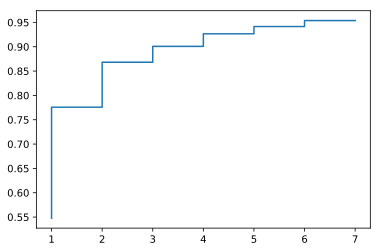

In [113]:
import matplotlib.pyplot as plt
plt.step(x[:-16],y[:-16])

In [114]:
with open("ev.csv","w") as f:
    for i in range(len(x[0:-16])):
        f.write(str(np.round(x[i],3))+","+str(np.round(y[i],3))+"\n")

In [69]:
df_imp_new = pd.DataFrame(df_imp.groupby(['customer_id', 'Action type'])['date'].count()).reset_index()

In [107]:
df_imp_new1 = df_imp_new.groupby('date').count().reset_index()

In [115]:
summa = int(df_imp_new1['Action type'].sum())
x = list(df_imp_new1['date'])
y = list(df_imp_new1['Action type'])
for i in range(1,len(x)):
    y[i] = (y[i-1] + y[i])
for i in range(len(x)):
    y[i] = y[i]/summa

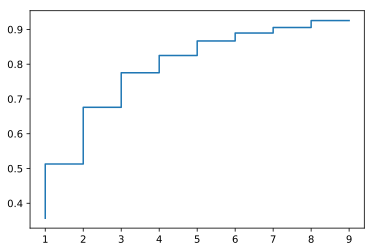

In [116]:
import matplotlib.pyplot as plt
plt.step(x[:-17],y[:-17])

In [117]:
with open("imp.csv","w") as f:
    for i in range(len(x[0:-17])):
        f.write(str(np.round(x[i],3))+","+str(np.round(y[i],3))+"\n")

In [15]:
#freq = pd.DataFrame(df_paths_1.groupby(["customer_id", "Action type"])["path_no"].count())

In [16]:
#freq_new = freq.reset_index()

In [17]:
#freq_new = freq_new[freq_new["Action type"].isin(["impression","event"])].sort_values("customer_id")

In [18]:
#freq_new.head(10)

In [90]:
#freq_new[freq_new["Action type"]=="impression"].median()

path_no    2.0
dtype: float64

In [19]:
#freq_new.groupby("customer_id").count().reset_index()
#freq_new["path_no2"] = freq_new["customer_id"].shift(1).fillna(0)
#freq_new.head()

In [92]:
#path = []
#list1 = list(freq_new["customer_id"])
#list2 = list(freq_new["path_no2"])
#i=0
#while i!=(freq_new.shape[0]-1):
#    if list1[i]==list1[i+1]:
#        path.append(int(2))
#        path.append(int(2))
#        i+=2
#    else:
#        path.append(int(1))
#        i+=1
#else:
#    path.append(int(1))

In [93]:
#freq_new["path_no2"] = path
#freq_new
#freq_new[(freq_new["path_no2"]==1) & (freq_new["Action type"]=="event")].groupby('customer_id').count().count()

,customer_id,Action type,path_no,path_no2
0,-07xkwNdKZf-,impression,3,1
2,-5ED7rfyHTv-,event,5,1
4,-@yv8jFpS2L-,event,14,2
5,-@yv8jFpS2L-,impression,3,2
7,-AdaU5c7Cjj8,impression,1,1
9,-HrapAU79c38,event,2,2
10,-HrapAU79c38,impression,10,2
12,-Mqylqmyw2D8,event,4,2
13,-Mqylqmyw2D8,impression,4,2
15,-OGWhLfk-578,impression,1,1


In [94]:
#freq_new[freq_new["path_no2"]==2].groupby('customer_id').count().count()

Action type    548
path_no        548
path_no2       548
dtype: int64

In [95]:
path1_imp = pd.DataFrame(freq_new[(freq_new["path_no2"]==1) & (freq_new["Action type"]=="impression")]["path_no"]).reset_index(drop=True)
path1_ev = pd.DataFrame(freq_new[(freq_new["path_no2"]==1) & (freq_new["Action type"]=="event")]["path_no"]).reset_index(drop=True)

In [96]:
path1_imp.head()

,path_no
0,3
1,1
2,1
3,3
4,7


In [97]:
path1_imp["path_no2"]=path1_imp["path_no"]#.groupby("path_no").count()
k = dict(path1_imp.groupby("path_no")["path_no2"].count())
summa = path1_imp.groupby("path_no")["path_no2"].count().sum()

In [98]:
x = (list(k.keys()))
x.append(0)
x = sorted(x)
y = np.zeros(len(x))
for i in range(1,len(x)):
    y[i] = y[i-1] + k[x[i]]/summa 

In [99]:
y

array([0.        , 0.42155689, 0.58802395, 0.74730539, 0.82275449,
       0.87185629, 0.90419162, 0.9257485 , 0.93413174, 0.94491018,
       0.95928144, 0.96766467, 0.97724551, 0.98083832, 0.98682635,
       0.98802395, 0.99161677, 0.99520958, 0.99760479, 0.9988024 ,
       1.        ])

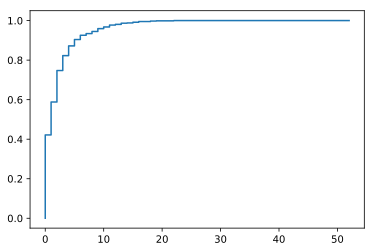

In [101]:
import matplotlib.pyplot as plt
plt.step(x[:],y[:])

In [109]:
y[8]

0.934131736526946

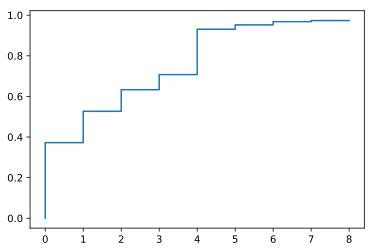

In [189]:
path1_ev["path_no2"]=path1_ev["path_no"]#.groupby("path_no").count()
k = dict(path1_ev.groupby("path_no")["path_no2"].count())
summa = path1_ev.groupby("path_no")["path_no2"].count().sum()
x = (list(k.keys()))
x.append(0)
x = sorted(x)
y = np.zeros(len(x))
for i in range(1,len(x)):
    y[i] = y[i-1] + k[x[i]]/summa 
import matplotlib.pyplot as plt
plt.step(x[0:-3],y[0:-3])

In [210]:
freq_new_p2 = freq_new[(freq_new["path_no2"]==2)].sort_values(["customer_id","Action type"])
freq_new_p2

,customer_id,Action type,path_no,path_no2
4,-@yv8jFpS2L-,event,14,2
5,-@yv8jFpS2L-,impression,3,2
9,-HrapAU79c38,event,2,2
10,-HrapAU79c38,impression,10,2
12,-Mqylqmyw2D8,event,4,2
13,-Mqylqmyw2D8,impression,4,2
21,-Uo5D2NXxDX9,event,14,2
22,-Uo5D2NXxDX9,impression,15,2
31,-b6XzVkKkUH9,event,7,2
32,-b6XzVkKkUH9,impression,3,2


In [211]:
list(map(int,list("1,3".split(","))))

[1, 3]

In [212]:
def agg_f(x):
     return pd.Series(dict(Sequence = ','.join(x['path_no'])))

массивы [ev, imp]

In [213]:
freq_new_p2["path_no"] = freq_new_p2["path_no"].astype(str)
freq_new_p2 = freq_new_p2.groupby('customer_id').apply(agg_f).reset_index()

In [216]:
#freq_new_p2["Sequence2"] = freq_new_p2["Sequence"]
freq_new_p2.groupby("Sequence").count().sort_values("customer_id",ascending=False)

,customer_id
Sequence,
"4,1",60
"1,1",47
"2,1",30
"3,1",22
"5,1",22
"1,2",12
"1,3",12
"4,4",12
"2,2",11


In [217]:
path1_imp = pd.DataFrame(freq_new[(freq_new["Action type"]=="impression")]["path_no"]).reset_index(drop=True)
path1_ev = pd.DataFrame(freq_new[(freq_new["Action type"]=="event")]["path_no"]).reset_index(drop=True)

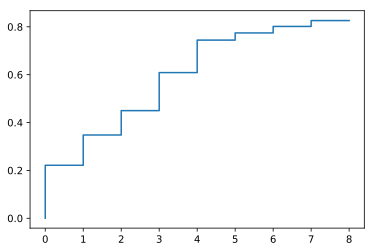

In [232]:
path1_ev["path_no2"]=path1_ev["path_no"]#.groupby("path_no").count()
k = dict(path1_ev.groupby("path_no")["path_no2"].count())
summa = path1_ev.groupby("path_no")["path_no2"].count().sum()
x = (list(k.keys()))
x.append(0)
x = sorted(x)
y = np.zeros(len(x))
for i in range(1,len(x)):
    y[i] = y[i-1] + k[x[i]]/summa 
import matplotlib.pyplot as plt
plt.step(x[0:-43],y[0:-43])
with open("ev.csv","w") as f:
    for i in range(len(x[0:-43])):
        f.write(str(np.round(x[i],3))+","+str(np.round(y[i],3))+"\n")

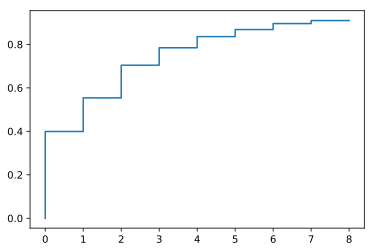

In [233]:
path1_imp["path_no2"]=path1_imp["path_no"]#.groupby("path_no").count()
k = dict(path1_imp.groupby("path_no")["path_no2"].count())
summa = path1_imp.groupby("path_no")["path_no2"].count().sum()
x = (list(k.keys()))
x.append(0)
x = sorted(x)
y = np.zeros(len(x))
for i in range(1,len(x)):
    y[i] = y[i-1] + k[x[i]]/summa 
import matplotlib.pyplot as plt
plt.step(x[0:-25],y[0:-25])
with open("imp.csv","w") as f:
    for i in range(len(x[0:-25])):
        f.write(str(np.round(x[i],3))+","+str(np.round(y[i],3))+"\n")

# 7 гипотеза

In [141]:
df

,Unnamed: 0,customer_id,date,channel,conversion,Conversion page ID,Insertion name,Conversion page name,Conversion type,Action type
0,0,-gF9bksAxIL@,2018-07-25 15:37:45,DBM,0,0,dbm_retarg_kasko,0,0,impression
1,1,-gF9bksAxIL@,2018-07-25 15:37:48,DBM,0,0,dbm_retarg_kasko,0,0,impression
2,2,-gF9bksAxIL@,2018-07-25 15:47:47,DBM,0,0,dbm_retarg_kasko,0,0,impression
3,3,-gF9bksAxIL@,2018-08-02 09:07:50,DBM,1,1460,dbm_retarg_kasko,[Ingos] Visitors 10 sec,impression,tracker
4,4,-gF9bksAxIL@,2018-08-02 09:08:11,DBM,1,1461,dbm_retarg_kasko,[Ingos] Visitors 30 sec,impression,tracker
5,5,-gF9bksAxIL@,2018-08-02 09:08:40,DBM,1,1462,dbm_retarg_kasko,[Ingos] visitors 60 sec,impression,tracker
6,6,-gF9bksAxIL@,2018-08-02 10:10:18,DBM,1,1491,dbm_retarg_kasko,[Ingos] Kasko_visitors,impression,tracker
7,7,-gF9bksAxIL@,2018-08-02 10:10:28,DBM,1,1460,dbm_retarg_kasko,[Ingos] Visitors 10 sec,impression,tracker
8,8,-gF9bksAxIL@,2018-08-02 10:10:48,DBM,1,1461,dbm_retarg_kasko,[Ingos] Visitors 30 sec,impression,tracker
9,9,-gF9bksAxIL@,2018-08-02 10:11:14,DBM,1,1460,dbm_retarg_kasko,[Ingos] Visitors 10 sec,impression,tracker


In [32]:
cond = list(df.groupby("customer_id")["Action type"].apply(lambda d: (d.shift().fillna(0)=='event') & (d=='tracker') ))

In [36]:
df_ = df[cond]

In [39]:
need_cookies = df_["customer_id"]
df_need = df[df["customer_id"].isin(need_cookies)]

In [49]:
df_need.sort_values('customer_id')

,Unnamed: 0,customer_id,date,channel,conversion,Conversion page ID,Insertion name,Conversion page name,Conversion type,Action type
7723,0,-5ED7rfyHTv-,2018-06-19 12:56:59,Mytarget_video,0,0,msk_video_3,0,0,event
7725,2,-5ED7rfyHTv-,2018-06-19 12:57:06,Mytarget_video,0,0,msk_video_3,0,0,event
7738,15,-5ED7rfyHTv-,2018-06-22 14:29:07,Mytarget_video,1,1527,msk_video_3,[Ingos] Travel_payment,event,tracker
7737,14,-5ED7rfyHTv-,2018-06-22 14:28:40,Mytarget_video,1,1490,msk_video_3,[Ingos] Travel_travel_formalize,event,tracker
7736,13,-5ED7rfyHTv-,2018-06-22 14:24:56,Mytarget_video,1,1463,msk_video_3,[Ingos] Chat,event,tracker
7734,11,-5ED7rfyHTv-,2018-06-22 14:22:14,Mytarget_video,1,1462,msk_video_3,[Ingos] visitors 60 sec,event,tracker
7733,10,-5ED7rfyHTv-,2018-06-22 14:21:44,Mytarget_video,1,1461,msk_video_3,[Ingos] Visitors 30 sec,event,tracker
7735,12,-5ED7rfyHTv-,2018-06-22 14:23:48,Mytarget_video,1,1489,msk_video_3,[Ingos] Travel_buy_online,event,tracker
7731,8,-5ED7rfyHTv-,2018-06-22 14:21:05,Mytarget_video,1,1487,msk_video_3,[Ingos] Travel_visitors,event,tracker
7730,7,-5ED7rfyHTv-,2018-06-22 14:21:01,Mytarget_video,1,1460,msk_video_3,[Ingos] Visitors 10 sec,event,tracker


In [142]:
ind_ev = df[(df['Action type']=='event') & (df['Action type'].shift(-1)=='tracker')].sort_values('customer_id').reset_index()
ind_ev = np.array(list(map(int,ind_ev["index"])))

In [143]:
ind_tr = df[(df['Action type']=='tracker') & (df['Action type'].shift()=='event')].sort_values('customer_id').reset_index()
ind_tr = np.array(list(map(int,ind_tr['index'])))

In [144]:
ind = np.concatenate((ind_ev, ind_tr))
ind = sorted(ind)

In [145]:
df_11 = df.loc[ind,:].sort_values(['customer_id','date'])

In [147]:
df_11 = df_11[['customer_id', 'date', 'Action type']]
df_11

,customer_id,date,Action type
7728,-5ED7rfyHTv-,2018-06-19 12:57:28,event
7729,-5ED7rfyHTv-,2018-06-22 14:20:52,tracker
24549,-Uo5D2NXxDX9,2018-06-28 10:03:57,event
24550,-Uo5D2NXxDX9,2018-07-26 13:16:13,tracker
29804,-b6XzVkKkUH9,2018-05-27 17:04:20,event
29805,-b6XzVkKkUH9,2018-06-15 19:24:59,tracker
7849,-cwL@FDxT1v9,2018-05-25 13:17:04,event
7850,-cwL@FDxT1v9,2018-06-01 13:10:21,tracker
34,-kWKAixAHVr@,2018-05-19 08:36:18,event
35,-kWKAixAHVr@,2018-05-31 07:14:32,tracker


In [148]:
df_11["shift_date"] = df_11.groupby("customer_id")["date"].shift(1).fillna(df_11['date'])
df_11

,customer_id,date,Action type,shift_date
7728,-5ED7rfyHTv-,2018-06-19 12:57:28,event,2018-06-19 12:57:28
7729,-5ED7rfyHTv-,2018-06-22 14:20:52,tracker,2018-06-19 12:57:28
24549,-Uo5D2NXxDX9,2018-06-28 10:03:57,event,2018-06-28 10:03:57
24550,-Uo5D2NXxDX9,2018-07-26 13:16:13,tracker,2018-06-28 10:03:57
29804,-b6XzVkKkUH9,2018-05-27 17:04:20,event,2018-05-27 17:04:20
29805,-b6XzVkKkUH9,2018-06-15 19:24:59,tracker,2018-05-27 17:04:20
7849,-cwL@FDxT1v9,2018-05-25 13:17:04,event,2018-05-25 13:17:04
7850,-cwL@FDxT1v9,2018-06-01 13:10:21,tracker,2018-05-25 13:17:04
34,-kWKAixAHVr@,2018-05-19 08:36:18,event,2018-05-19 08:36:18
35,-kWKAixAHVr@,2018-05-31 07:14:32,tracker,2018-05-19 08:36:18


In [149]:
df_11['date'] = pd.to_datetime(df_11['date'])
df_11['shift_date'] = pd.to_datetime(df_11['shift_date'])
df_11["pause_visit"] = df_11["date"] - df_11["shift_date"]
print(df_11.shape[0]/2, 'всего случаев')
df_11

624.0 всего случаев


,customer_id,date,Action type,shift_date,pause_visit
7728,-5ED7rfyHTv-,2018-06-19 12:57:28,event,2018-06-19 12:57:28,0 days 00:00:00
7729,-5ED7rfyHTv-,2018-06-22 14:20:52,tracker,2018-06-19 12:57:28,3 days 01:23:24
24549,-Uo5D2NXxDX9,2018-06-28 10:03:57,event,2018-06-28 10:03:57,0 days 00:00:00
24550,-Uo5D2NXxDX9,2018-07-26 13:16:13,tracker,2018-06-28 10:03:57,28 days 03:12:16
29804,-b6XzVkKkUH9,2018-05-27 17:04:20,event,2018-05-27 17:04:20,0 days 00:00:00
29805,-b6XzVkKkUH9,2018-06-15 19:24:59,tracker,2018-05-27 17:04:20,19 days 02:20:39
7849,-cwL@FDxT1v9,2018-05-25 13:17:04,event,2018-05-25 13:17:04,0 days 00:00:00
7850,-cwL@FDxT1v9,2018-06-01 13:10:21,tracker,2018-05-25 13:17:04,6 days 23:53:17
34,-kWKAixAHVr@,2018-05-19 08:36:18,event,2018-05-19 08:36:18,0 days 00:00:00
35,-kWKAixAHVr@,2018-05-31 07:14:32,tracker,2018-05-19 08:36:18,11 days 22:38:14


In [162]:
cond = list(df_11.groupby("customer_id")["pause_visit"].apply(lambda d: ((d-d.shift()).fillna(0) == '0 seconds') | ((d-d.shift()).fillna(0) > "900 seconds")))

In [152]:
df_11.head()

,customer_id,date,Action type,shift_date,pause_visit
7728,-5ED7rfyHTv-,2018-06-19 12:57:28,event,2018-06-19 12:57:28,0 days 00:00:00
7729,-5ED7rfyHTv-,2018-06-22 14:20:52,tracker,2018-06-19 12:57:28,3 days 01:23:24
24549,-Uo5D2NXxDX9,2018-06-28 10:03:57,event,2018-06-28 10:03:57,0 days 00:00:00
24550,-Uo5D2NXxDX9,2018-07-26 13:16:13,tracker,2018-06-28 10:03:57,28 days 03:12:16
29804,-b6XzVkKkUH9,2018-05-27 17:04:20,event,2018-05-27 17:04:20,0 days 00:00:00


In [163]:
df_need = df_11[cond]
#df_need[df_need['Action type']==]

In [164]:
df_need.sort_values('customer_id')

,customer_id,date,Action type,shift_date,pause_visit
7728,-5ED7rfyHTv-,2018-06-19 12:57:28,event,2018-06-19 12:57:28,0 days 00:00:00
7729,-5ED7rfyHTv-,2018-06-22 14:20:52,tracker,2018-06-19 12:57:28,3 days 01:23:24
24549,-Uo5D2NXxDX9,2018-06-28 10:03:57,event,2018-06-28 10:03:57,0 days 00:00:00
24550,-Uo5D2NXxDX9,2018-07-26 13:16:13,tracker,2018-06-28 10:03:57,28 days 03:12:16
29804,-b6XzVkKkUH9,2018-05-27 17:04:20,event,2018-05-27 17:04:20,0 days 00:00:00
29805,-b6XzVkKkUH9,2018-06-15 19:24:59,tracker,2018-05-27 17:04:20,19 days 02:20:39
7849,-cwL@FDxT1v9,2018-05-25 13:17:04,event,2018-05-25 13:17:04,0 days 00:00:00
7850,-cwL@FDxT1v9,2018-06-01 13:10:21,tracker,2018-05-25 13:17:04,6 days 23:53:17
35,-kWKAixAHVr@,2018-05-31 07:14:32,tracker,2018-05-19 08:36:18,11 days 22:38:14
34,-kWKAixAHVr@,2018-05-19 08:36:18,event,2018-05-19 08:36:18,0 days 00:00:00


In [166]:
df_need.shape[0]/2

601.0

In [168]:
624-601

23

In [169]:
np.round(23/624*100,2)

3.69

In [170]:
3.7-100

-96.3

In [171]:
458/1563

0.2930262316058861

In [172]:
(540+188)/1563

0.4657709532949456

In [20]:
(835+540)/1563

0.8797184900831734